**1.   Clean Data**

Before cleaning data it is necessary to install the standard libraries and make the profiling.




In [1]:
!pip install -U pandas-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 2.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.6/357.6 kB 19.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 381.9/381.9 kB 33.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 15.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 31.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 32.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 53.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 80.7 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=611001be7e4d6926532dc0d3390dde6f88d4bc8b3dab6eb2e88b5967d1615251
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attempting unin

In [2]:
# Standard Library Imports
from pathlib import Path

# Installed packages
import pandas as pd
import matplotlib.pyplot as plt
import io
from sklearn.linear_model import LinearRegression
import seaborn as sns
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

# Our package
from ydata_profiling import ProfileReport
from ydata_profiling.utils.cache import cache_file

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# transforming the csv into a pandas data frame

house = pd.read_csv('/content/drive/MyDrive/Notebooks/house_data.csv')

house.head()

,Id,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,MasVnrType,Heating,CentralAir,GrLivArea,...,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MoSold,YrSold,SalePrice
0,1,65.0,8450,7,5,2003,BrkFace,GasA,Y,1710,...,Y,0,61,0,0,0,0,2,2008,208500
1,2,80.0,9600,6,8,1976,None,GasA,Y,1262,...,Y,298,0,0,0,0,0,5,2007,181500
2,3,68.0,11250,7,5,2001,BrkFace,GasA,Y,1786,...,Y,0,42,0,0,0,0,9,2008,223500
3,4,60.0,9550,7,5,1915,None,GasA,Y,1717,...,Y,0,35,272,0,0,0,2,2006,140000
4,5,84.0,14260,8,5,2000,BrkFace,GasA,Y,2198,...,Y,192,84,0,0,0,0,12,2008,250000


For the first exploratory analysis, it was performed the profiling method. Here, it was possible to have the general picture of the shape of the dataset (rows and columns), missing cells, duplicate rows, variable types, min and max, among others.

In [4]:
# Generate the Profiling Report
profile = ProfileReport(house, title="House", html={"style": {"full_width": True}}, sort=None)

In [5]:
# Just to get a sense of the data
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
# Remover a coluna 'ID'
house = house.drop('Id', axis=1)


In [7]:
num_observations = house.shape[0]
num_features = house.shape[1]
print(f"The dataset has {num_observations} observations (rows) and {num_features} features (columns; including the label (SalePrice)).")

print("___//___")

#This gives us a whole picture of the dataset, which I think that can also define its shape.
print(house.info())

The dataset has 1460 observations (rows) and 31 features (columns; including the label (SalePrice)).
___//___
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 31 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   LotFrontage    1201 non-null   float64
 1   LotArea        1460 non-null   int64  
 2   OverallQual    1460 non-null   int64  
 3   OverallCond    1460 non-null   int64  
 4   YearBuilt      1460 non-null   int64  
 5   MasVnrType     1452 non-null   object 
 6   Heating        1460 non-null   object 
 7   CentralAir     1460 non-null   object 
 8   GrLivArea      1460 non-null   int64  
 9   BsmtFullBath   1460 non-null   int64  
 10  BsmtHalfBath   1460 non-null   int64  
 11  FullBath       1460 non-null   int64  
 12  HalfBath       1460 non-null   int64  
 13  BedroomAbvGr   1460 non-null   int64  
 14  KitchenAbvGr   1460 non-null   int64  
 15  KitchenQual    1460 non-null  

The distribution analysis of the label (SalePrice):

Median: 163000.0
Mean: 180694.48
Standard Deviation: 79957.18


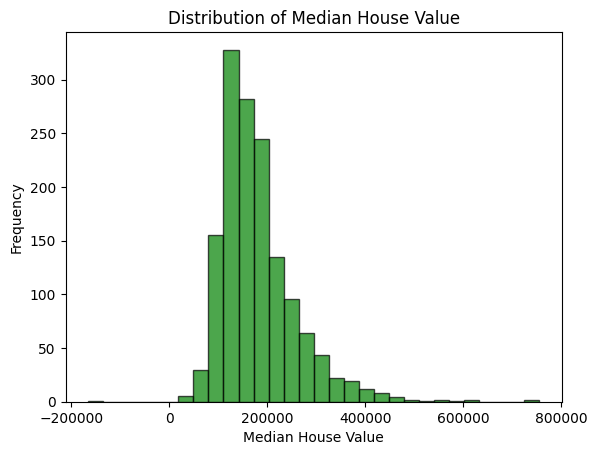

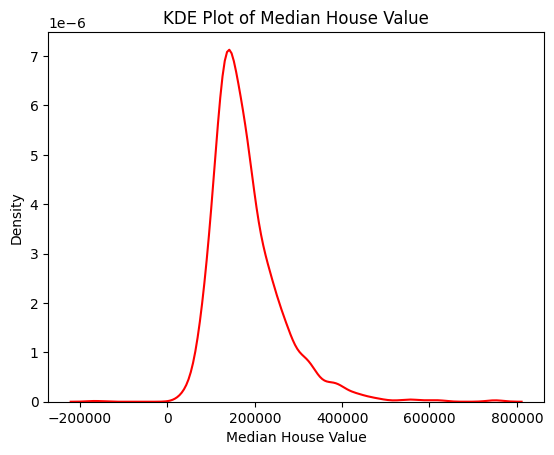

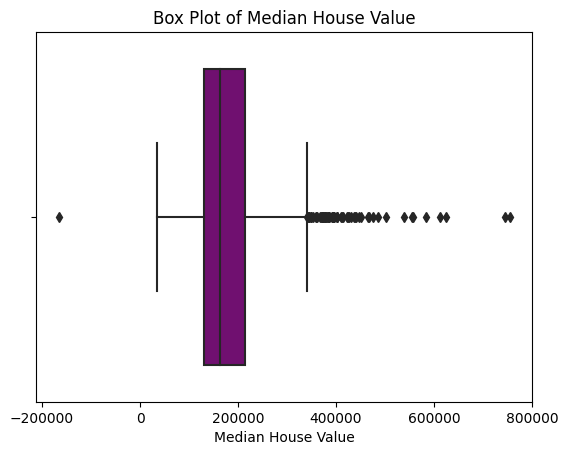

In [8]:
#SalePrice - Median value of owner-occupied homes in $1000's
median_value = house['SalePrice'].median()
mean_value = house['SalePrice'].mean()
std_deviation = house['SalePrice'].std()

print(f"Median: {median_value}")
print(f"Mean: {mean_value:.2f}")
print(f"Standard Deviation: {std_deviation:.2f}")

plt.hist(house['SalePrice'], bins=30, color='green', alpha=0.7, edgecolor='black')
plt.xlabel('Median House Value')
plt.ylabel('Frequency')
plt.title('Distribution of Median House Value')
plt.show()

sns.kdeplot(house['SalePrice'], color='red')
plt.xlabel('Median House Value')
plt.ylabel('Density')
plt.title('KDE Plot of Median House Value')
plt.show()

sns.boxplot(x=house['SalePrice'], color='purple')
plt.xlabel('Median House Value')
plt.title('Box Plot of Median House Value')
plt.show()

**1.1. Wrong text entries**

As the space in "GarageCond" and the "None" on "MasVnrType". These were consideres as NaN:


In [9]:
for c in house.columns:
    unique_values = house[c].unique()
    if house[c].dtype == 'object':
        print(c, unique_values)

MasVnrType ['BrkFace' 'None' 'Stone' 'BrkCmn' nan]
Heating ['GasA' 'GasW' 'Grav' 'Wall' 'OthW' 'Floor']
CentralAir ['Y' 'M' 'N']
KitchenQual ['Gd' 'TA' 'Ex' 'Fa']
GarageQual ['TA' 'Fa' 'Gd' nan 'Ex' 'Po']
GarageCond ['TA' ' ' 'Fa' nan 'Gd' 'Po' 'Ex']
PavedDrive ['Y' 'N' 'P']


In [10]:
import numpy as np

house['MasVnrType'] = house['MasVnrType'].replace('None', np.nan)
house['GarageCond'] = house['GarageCond'].replace(' ', np.nan)

# Exiba o DataFrame atualizado
print(house[['MasVnrType']])
print(house[['GarageCond']])


     MasVnrType
0       BrkFace
1           NaN
2       BrkFace
3           NaN
4       BrkFace
...         ...
1455        NaN
1456      Stone
1457        NaN
1458        NaN
1459        NaN

[1460 rows x 1 columns]
     GarageCond
0            TA
1            TA
2            TA
3            TA
4            TA
...         ...
1455         TA
1456         TA
1457         TA
1458         TA
1459         TA

[1460 rows x 1 columns]


In [11]:
#To check
for c in house.columns:
    unique_values = house[c].unique()
    if house[c].dtype == 'object':
        print(c, unique_values)

MasVnrType ['BrkFace' nan 'Stone' 'BrkCmn']
Heating ['GasA' 'GasW' 'Grav' 'Wall' 'OthW' 'Floor']
CentralAir ['Y' 'M' 'N']
KitchenQual ['Gd' 'TA' 'Ex' 'Fa']
GarageQual ['TA' 'Fa' 'Gd' nan 'Ex' 'Po']
GarageCond ['TA' nan 'Fa' 'Gd' 'Po' 'Ex']
PavedDrive ['Y' 'N' 'P']


In the case of the "M" on "CentralAir" it was considered a typo, and so replaced to "N":

In [12]:
# Supondo que 'house' seja o seu DataFrame
house['CentralAir'] = house['CentralAir'].replace('M', 'N')

# Verifique se a substituição foi bem-sucedida
print(house['CentralAir'].value_counts())


Y    1364
N      96
Name: CentralAir, dtype: int64


**1.3. Wrong values entries**

Next, it was confirmed the minimum and maximum of the int64 columns.
Through this analysis, and as suggested in the profiling evaluation, it was possible to identify situations when:

*   YearBuilt > current Year
*   SalePrice < 0




In [13]:
for column in house.select_dtypes(include='int64').columns:
    min_value = house[column].min()
    max_value = house[column].max()
    print(f"{column}: Minimum = {min_value}, Maximum = {max_value}")


LotArea: Minimum = 1300, Maximum = 215245
OverallQual: Minimum = 1, Maximum = 10
OverallCond: Minimum = 1, Maximum = 9
YearBuilt: Minimum = 1872, Maximum = 3000
GrLivArea: Minimum = 334, Maximum = 5642
BsmtFullBath: Minimum = 0, Maximum = 3
BsmtHalfBath: Minimum = 0, Maximum = 2
FullBath: Minimum = 0, Maximum = 3
HalfBath: Minimum = 0, Maximum = 2
BedroomAbvGr: Minimum = 0, Maximum = 8
KitchenAbvGr: Minimum = 0, Maximum = 3
TotRmsAbvGrd: Minimum = 2, Maximum = 14
Fireplaces: Minimum = 0, Maximum = 3
GarageArea: Minimum = 0, Maximum = 1418
WoodDeckSF: Minimum = 0, Maximum = 857
OpenPorchSF: Minimum = 0, Maximum = 547
EnclosedPorch: Minimum = 0, Maximum = 552
3SsnPorch: Minimum = 0, Maximum = 508
ScreenPorch: Minimum = 0, Maximum = 480
PoolArea: Minimum = 0, Maximum = 738
MoSold: Minimum = 1, Maximum = 12
YrSold: Minimum = 2006, Maximum = 2010
SalePrice: Minimum = -165500, Maximum = 755000


In [14]:
from datetime import datetime

# Obtendo o ano atual
current_year = datetime.now().year

# Filtrando os registros
filtered_records = house[(house['YearBuilt'] > current_year) | (house['SalePrice'] < 0)]

# Exibindo os registros filtrados
print(filtered_records)


     LotFrontage  LotArea  OverallQual  OverallCond  YearBuilt MasVnrType  \
27          98.0    11478            8            5       2100      Stone   
33          70.0    10552            5            5       1959        NaN   
297         66.0     7399            7            5       3000    BrkFace   

    Heating CentralAir  GrLivArea  BsmtFullBath  ...  PavedDrive  WoodDeckSF  \
27     GasA          Y       1704             1  ...           Y           0   
33     GasA          Y       1700             0  ...           Y           0   
297    GasA          Y       1950             0  ...           Y           0   

     OpenPorchSF  EnclosedPorch  3SsnPorch ScreenPorch  PoolArea  MoSold  \
27            50              0          0           0         0       5   
33            38              0          0           0         0       4   
297           10              0          0         198         0       6   

     YrSold SalePrice  
27     2010    306000  
33     2010   -16

*For the negative SalePrice:*

It was decided to substitute the negative SalePrice by the average of the other SalePrices with the same year of construction and similar LotArea.

      LotFrontage  LotArea  OverallQual  OverallCond  YearBuilt MasVnrType  \
33           70.0    10552            5            5       1959        NaN   
656          72.0    10007            5            7       1959    BrkFace   
1425         80.0    10721            6            6       1959      Stone   

     Heating CentralAir  GrLivArea  BsmtFullBath  ...  PavedDrive  WoodDeckSF  \
33      GasA          Y       1700             0  ...           Y           0   
656     GasA          Y       1053             1  ...           Y           0   
1425    GasA          Y       1252             0  ...           Y           0   

      OpenPorchSF  EnclosedPorch  3SsnPorch ScreenPorch  PoolArea  MoSold  \
33             38              0          0           0         0       4   
656             0              0          0           0         0       8   
1425           39              0          0           0         0      10   

      YrSold SalePrice  
33      2010   -165500  
656

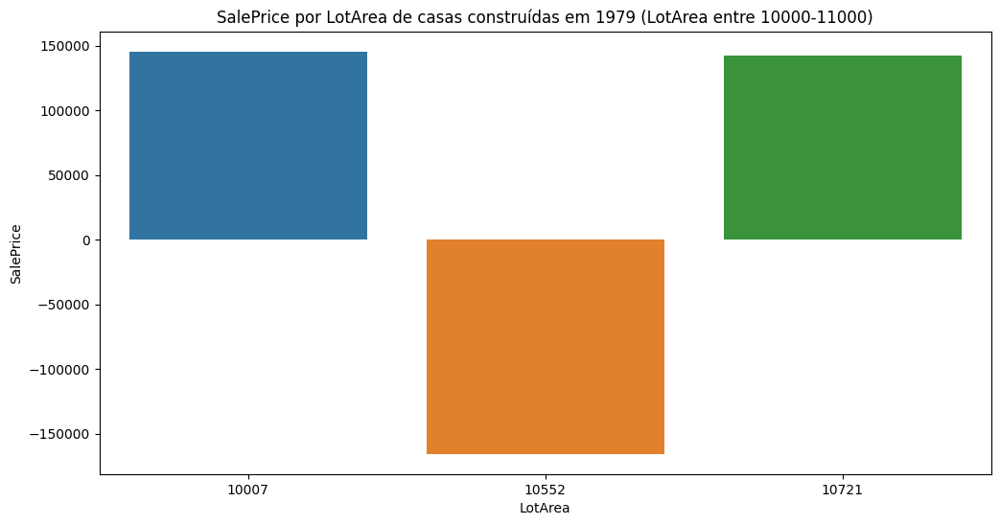

In [15]:
# Filtrando os dados para YearBuilt=1979 e LotArea entre 10000-11000
filtered_data = house[(house['YearBuilt'] == 1959) & (house['LotArea'].between(10000, 11000))]
print(filtered_data)

# Criando o gráfico de barras
plt.figure(figsize=(12, 6))
sns.barplot(x='LotArea', y='SalePrice', data=filtered_data)

# Adicionando rótulos e título
plt.xlabel('LotArea')
plt.ylabel('SalePrice')
plt.title('SalePrice por LotArea de casas construídas em 1979 (LotArea entre 10000-11000)')

# Exibindo o gráfico
plt.show()


In [16]:
# Filtrando os dados
filtered_data = house[(house['YearBuilt'] == 1959) & (house['LotArea'].between(10000, 11000)) & (house['SalePrice'] > 0)]

# Calculando a média do SalePrice para o subconjunto filtrado
mean_sale_price = filtered_data['SalePrice'].mean()

# Substituindo o valor -165500 pela média calculada
house.loc[(house['YearBuilt'] == 1959) & (house['LotArea'].between(10000, 11000)) & (house['SalePrice'] == -165500), 'SalePrice'] = mean_sale_price

In [17]:
#To check
# Filtrando os dados para YearBuilt=1979 e LotArea entre 10000-11000
filtered_data = house[(house['YearBuilt'] == 1959) & (house['LotArea'].between(10000, 11000))]
print(filtered_data)


      LotFrontage  LotArea  OverallQual  OverallCond  YearBuilt MasVnrType  \
33           70.0    10552            5            5       1959        NaN   
656          72.0    10007            5            7       1959    BrkFace   
1425         80.0    10721            6            6       1959      Stone   

     Heating CentralAir  GrLivArea  BsmtFullBath  ...  PavedDrive  WoodDeckSF  \
33      GasA          Y       1700             0  ...           Y           0   
656     GasA          Y       1053             1  ...           Y           0   
1425    GasA          Y       1252             0  ...           Y           0   

      OpenPorchSF  EnclosedPorch  3SsnPorch ScreenPorch  PoolArea  MoSold  \
33             38              0          0           0         0       4   
656             0              0          0           0         0       8   
1425           39              0          0           0         0      10   

      YrSold SalePrice  
33      2010    143750  
656

*For the huge YrBuilt:*

As seen earlier, there are two rows with the YearBuilt higher than the current year, which are 2100 and 3000.
It seemed that was supposed to be a year from the XXI century. In this sense, it was considered the YearBuilt of the mean houses number, after filtrating the data.


In [18]:
# Substituindo 2100 e 3000 por NaN temporariamente
house['YearBuilt'] = house['YearBuilt'].replace([2100, 3000], np.nan)

# Filtrando os dados para os anos entre 2000 e 2010
filtered_data = house[(house['YearBuilt'] >= 2000) & (house['YearBuilt'] < 2010)]

# Agrupando por YearBuilt e contando o número de casas em cada ano
houses_per_year = filtered_data.groupby('YearBuilt').size()

# Encontrando o YearBuilt com o número médio mais alto de casas
year_with_highest_average = houses_per_year.idxmax()
print(f'O YearBuilt com o número médio mais alto de casas entre 2000 e 2010 é: {year_with_highest_average}')

# Substituindo os NaN pelos anos com o número médio mais alto
house['YearBuilt'] = house['YearBuilt'].fillna(year_with_highest_average)

#To check
max_year_built = house['YearBuilt'].max()
print("O valor máximo de YearBuilt é:", max_year_built)



O YearBuilt com o número médio mais alto de casas entre 2000 e 2010 é: 2006.0
O valor máximo de YearBuilt é: 2010.0


**1.3. Missing Values and spaces**

In [19]:
missing_values_column = house.isna().sum()
print(missing_values_column)
print("___//___")

missing_values_row =  house.isna().any(axis=1).sum()
print(f"Existem {missing_values_row} linhas com pelo menos um valor ausente.")

LotFrontage      259
LotArea            0
OverallQual        0
OverallCond        0
YearBuilt          0
MasVnrType       872
Heating            0
CentralAir         0
GrLivArea          0
BsmtFullBath       0
BsmtHalfBath       0
FullBath           0
HalfBath           0
BedroomAbvGr       0
KitchenAbvGr       0
KitchenQual        0
TotRmsAbvGrd       0
Fireplaces         0
GarageArea         0
GarageQual        81
GarageCond        85
PavedDrive         0
WoodDeckSF         0
OpenPorchSF        0
EnclosedPorch      0
3SsnPorch          0
ScreenPorch        0
PoolArea           0
MoSold             0
YrSold             0
SalePrice          0
dtype: int64
___//___
Existem 1002 linhas com pelo menos um valor ausente.


In [20]:
# Calcular a percentagem de NaN em cada coluna
percentagem_nan = (house.isna().mean() * 100).round(2)
print(percentagem_nan)


LotFrontage      17.74
LotArea           0.00
OverallQual       0.00
OverallCond       0.00
YearBuilt         0.00
MasVnrType       59.73
Heating           0.00
CentralAir        0.00
GrLivArea         0.00
BsmtFullBath      0.00
BsmtHalfBath      0.00
FullBath          0.00
HalfBath          0.00
BedroomAbvGr      0.00
KitchenAbvGr      0.00
KitchenQual       0.00
TotRmsAbvGrd      0.00
Fireplaces        0.00
GarageArea        0.00
GarageQual        5.55
GarageCond        5.82
PavedDrive        0.00
WoodDeckSF        0.00
OpenPorchSF       0.00
EnclosedPorch     0.00
3SsnPorch         0.00
ScreenPorch       0.00
PoolArea          0.00
MoSold            0.00
YrSold            0.00
SalePrice         0.00
dtype: float64


In [21]:
# Remover colunas
house = house.drop('LotFrontage', axis=1)
house = house.drop('MasVnrType', axis=1)

In [22]:
# Considerar que os NaN das Garage são "No Garage (NG)"
house['GarageQual'] = house['GarageQual'].fillna('NG')
house['GarageCond'] = house['GarageCond'].fillna('NG')


In [23]:
#To check
missing_values_column = house.isna().sum()
print(missing_values_column)
print("___//___")

missing_values_row =  house.isna().any(axis=1).sum()
print(f"Existem {missing_values_row} linhas com pelo menos um valor ausente.")

LotArea          0
OverallQual      0
OverallCond      0
YearBuilt        0
Heating          0
CentralAir       0
GrLivArea        0
BsmtFullBath     0
BsmtHalfBath     0
FullBath         0
HalfBath         0
BedroomAbvGr     0
KitchenAbvGr     0
KitchenQual      0
TotRmsAbvGrd     0
Fireplaces       0
GarageArea       0
GarageQual       0
GarageCond       0
PavedDrive       0
WoodDeckSF       0
OpenPorchSF      0
EnclosedPorch    0
3SsnPorch        0
ScreenPorch      0
PoolArea         0
MoSold           0
YrSold           0
SalePrice        0
dtype: int64
___//___
Existem 0 linhas com pelo menos um valor ausente.


**1.3. Outliers**


There are some outliers, in some features, but there were kept due to the business purpose.


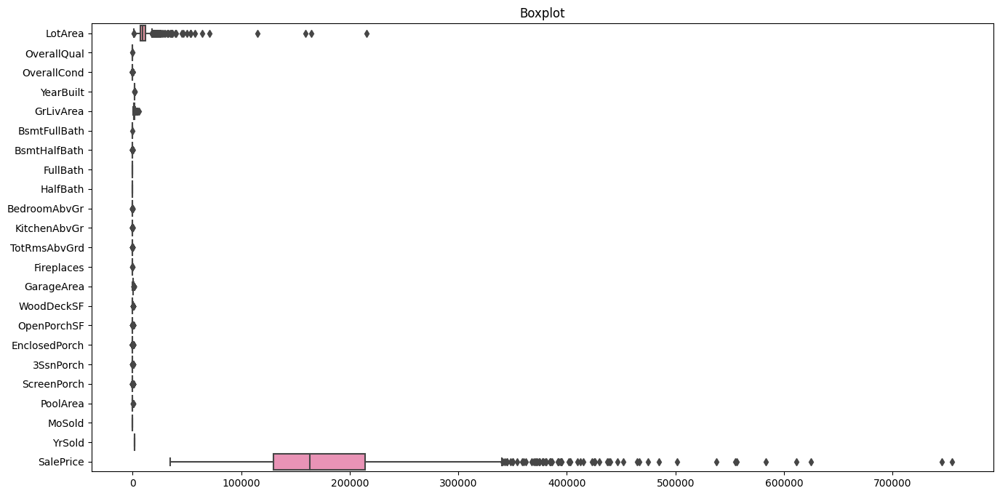

In [24]:
#General picture
# Configurando o tamanho da figura
plt.figure(figsize=(16, 8))

# Criando um boxplot para cada coluna numérica
sns.boxplot(data=house, orient="h")

# Adicionando título ao gráfico
plt.title('Boxplot')

# Exibindo o gráfico
plt.show()

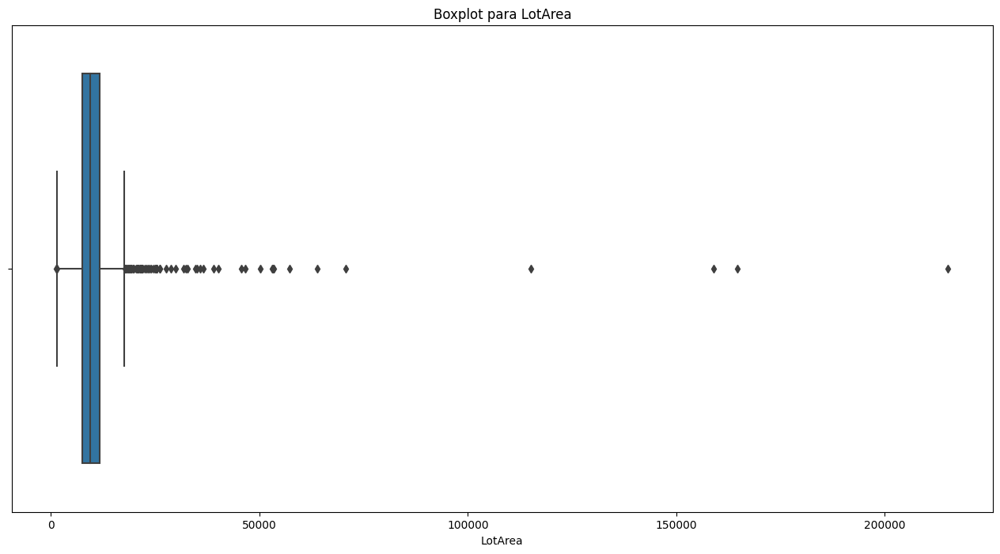

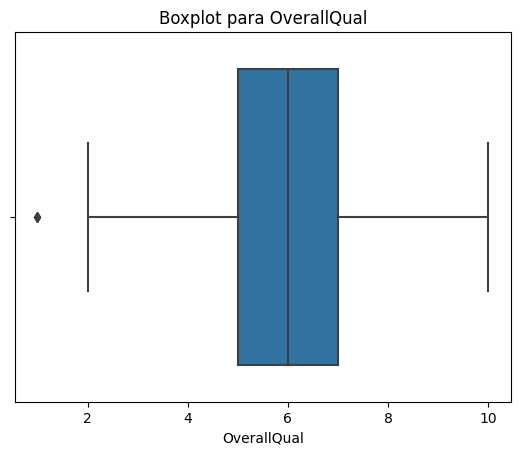

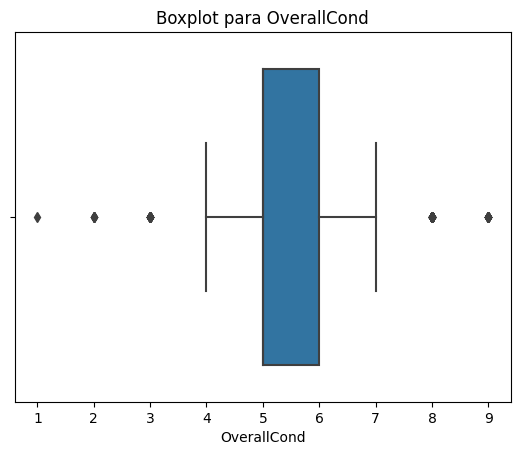

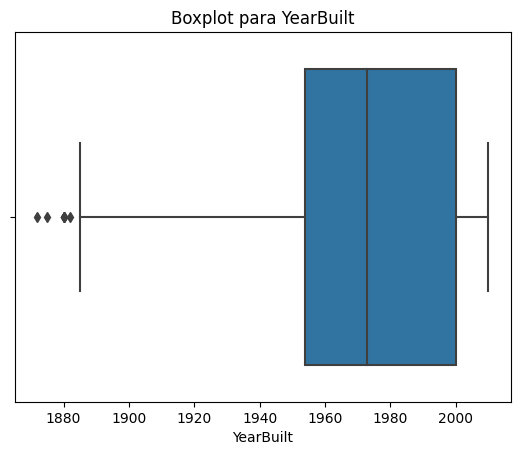

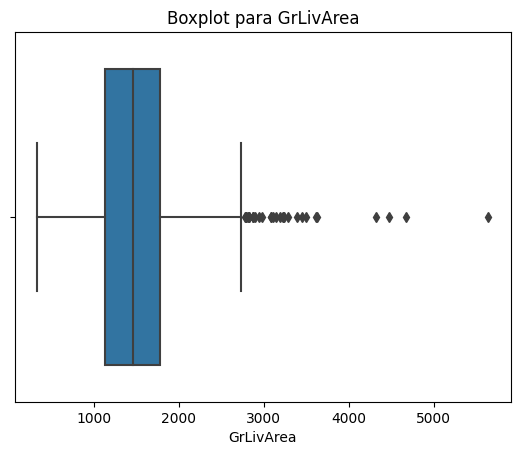

...

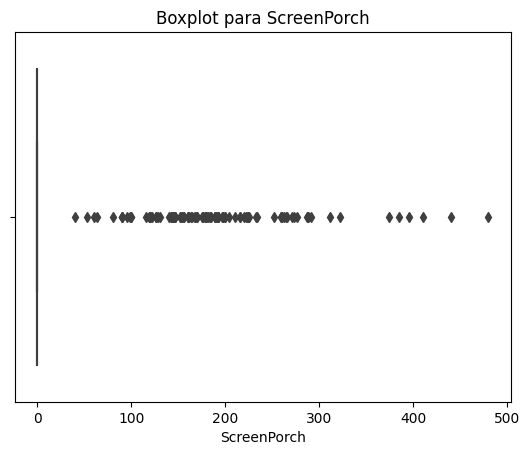

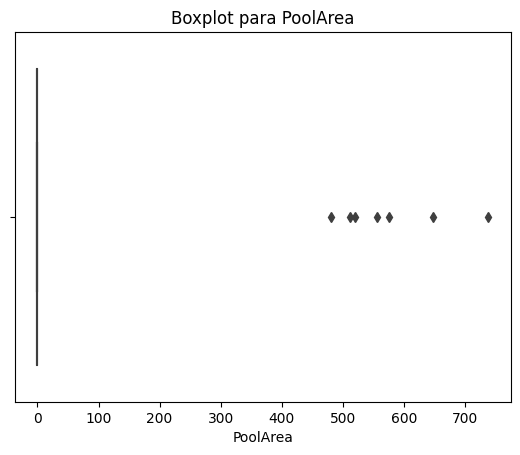

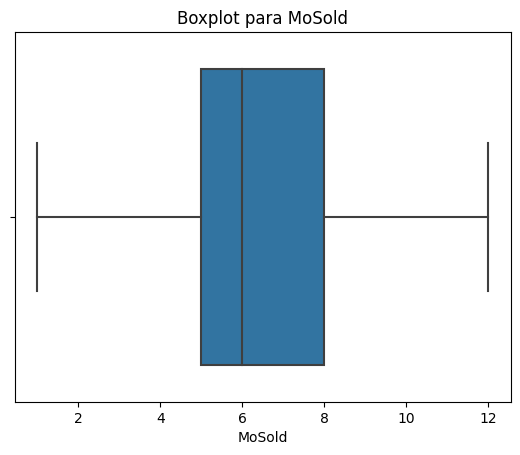

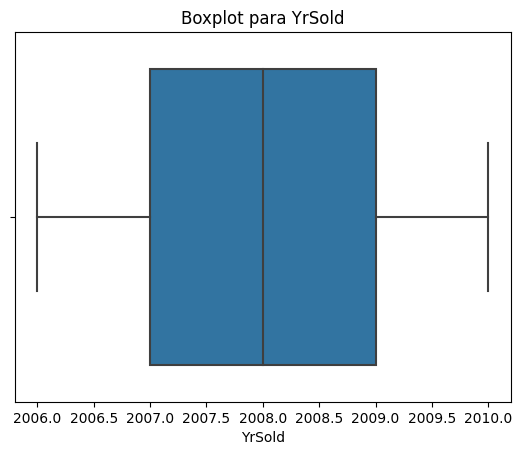

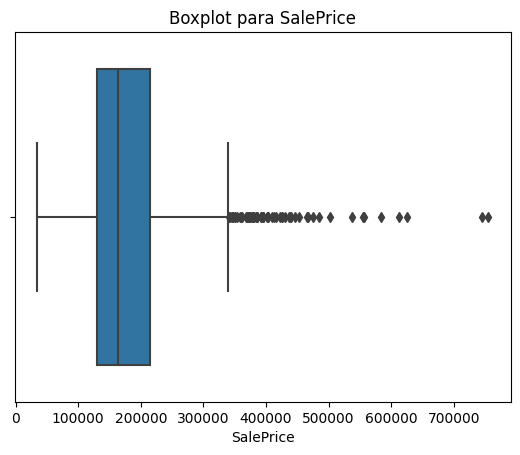

In [25]:
# Configurando o tamanho da figura
plt.figure(figsize=(16, 8))

# Iterando sobre as colunas do DataFrame
for column in house.columns:
    # Verificando se a coluna é numérica
    if house[column].dtype in ['int64', 'float64']:
        # Criando um boxplot para cada coluna numérica
        sns.boxplot(x=house[column])

        # Adicionando título ao gráfico
        plt.title(f'Boxplot para {column}')

        # Exibindo o gráfico
        plt.show()


**2. Transform at least two of the categorical features into numerical features. One of them has to be ordinal and the other nominal.**

In [27]:
#Categorical into ordinal (with specific order)

# Mapeamento de valores para KitchenQual
kitchen_qual_mapping = {
    'Ex': 5,
    'Gd': 4,
    'TA': 3,
    'Fa': 2,
    'Po': 1
}

# Substituir os valores
house['KitchenQual'] = house['KitchenQual'].map(kitchen_qual_mapping)

# Exibindo o DataFrame resultante
print(house[['KitchenQual']])


      KitchenQual
0               4
1               3
2               4
3               4
4               4
...           ...
1455            3
1456            3
1457            4
1458            4
1459            3

[1460 rows x 1 columns]


In [28]:
#Categorical into nominal (without order)

# Selecione a coluna "Heating" e aplique a transformação usando a função map
house['Heating'] = house['Heating'].map({
    'Floor': 6,
    'GasA': 5,
    'GasW': 4,
    'Grav': 3,
    'OthW': 2,
    'Wall': 1
})

# Exiba o DataFrame atualizado
print(house[['Heating']])


      Heating
0           5
1           5
2           5
3           5
4           5
...       ...
1455        5
1456        5
1457        5
1458        5
1459        5

[1460 rows x 1 columns]


**3. Create at least one new feature.**

It was created the feature "Age", which give the age of the house (current year - YearBuilt)

In [29]:
from datetime import datetime

# Converta a coluna 'YearBuilt' para numérico
house['YearBuilt'] = pd.to_numeric(house['YearBuilt'], errors='coerce')

# Converta a coluna 'YrSold' para numérico
house['YrSold'] = pd.to_numeric(house['YrSold'], errors='coerce')

# Calcule a idade da casa com base no ano de venda
house['Age'] = house['YrSold'] - house['YearBuilt']

# Exiba o DataFrame atualizado
print(house[['YearBuilt', 'YrSold', 'Age']])


      YearBuilt  YrSold   Age
0        2003.0    2008   5.0
1        1976.0    2007  31.0
2        2001.0    2008   7.0
3        1915.0    2006  91.0
4        2000.0    2008   8.0
...         ...     ...   ...
1455     1999.0    2007   8.0
1456     1978.0    2010  32.0
1457     1941.0    2010  69.0
1458     1950.0    2010  60.0
1459     1965.0    2008  43.0

[1460 rows x 3 columns]


**4. Create a copy of the dataframe select 3 features plus a label? (select the most important features)**

Through the correlation analysis it was possible to check the features that highly correlated with the label (SalePrice). In this line of thought, the top 3 were chosen for the new dataset: OverallQual (0.79), GrLivArea (0.71) and GarageArea (0.62) are the top3 most correlated with the label (SalePrice).

<ipython-input-30-4bc81640347f>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = house.corr()


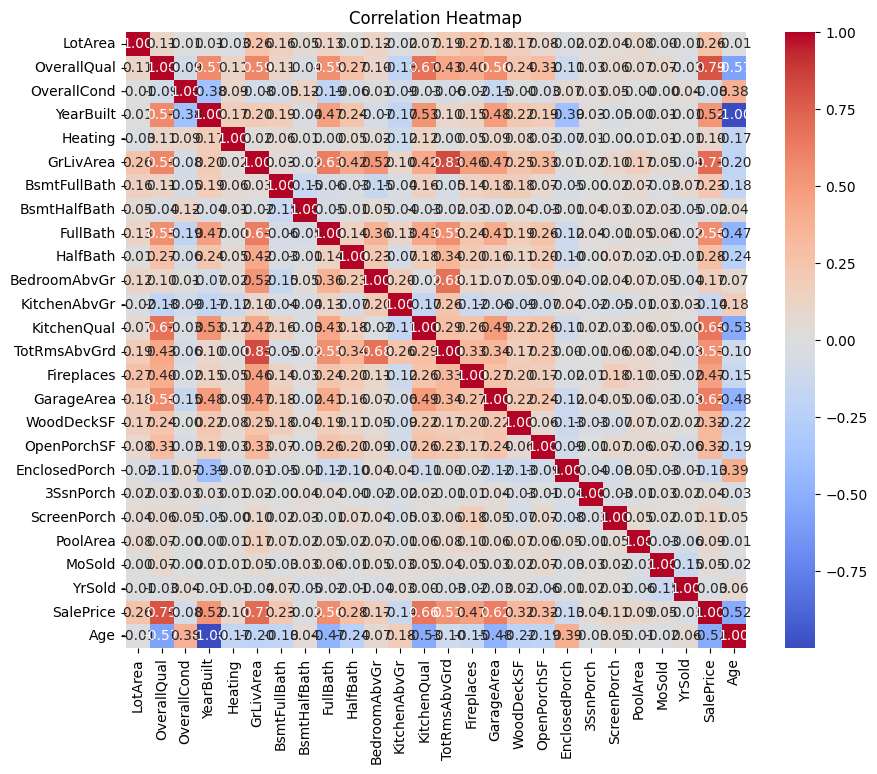

In [30]:
#the corr() method calculates the Pearson correlation coefficient for all pairs of numeric features in the DataFrame.
correlation_matrix = house.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()

In [32]:
# Supondo que 'house' seja o seu DataFrame
colunas_desejadas = ['OverallQual', 'GrLivArea', 'GarageArea', 'SalePrice']
house_new = house[colunas_desejadas].copy()

# Exiba o novo DataFrame
print(house_new)


      OverallQual  GrLivArea  GarageArea  SalePrice
0               7       1710         548     208500
1               6       1262         460     181500
2               7       1786         608     223500
3               7       1717         642     140000
4               8       2198         836     250000
...           ...        ...         ...        ...
1455            6       1647         460     175000
1456            6       2073         500     210000
1457            7       2340         252     266500
1458            5       1078         240     142125
1459            5       1256         276     147500

[1460 rows x 4 columns]


**5. Normalize the data of the new dataframe.**

In [35]:
from sklearn.preprocessing import MinMaxScaler

# Assuming 'novo_dataset' is your new DataFrame
cols_to_normalize = ['OverallQual', 'GrLivArea', 'GarageArea', 'SalePrice']

# Create a MinMaxScaler
scaler = MinMaxScaler()

# Apply the scaler to the selected columns
house_new[cols_to_normalize] = scaler.fit_transform(house_new[cols_to_normalize])

# Display the normalized DataFrame
print(house_new)


      OverallQual  GrLivArea  GarageArea  SalePrice
0        0.666667   0.259231    0.386460   0.241078
1        0.555556   0.174830    0.324401   0.203583
2        0.666667   0.273549    0.428773   0.261908
3        0.666667   0.260550    0.452750   0.145952
4        0.777778   0.351168    0.589563   0.298709
...           ...        ...         ...        ...
1455     0.555556   0.247362    0.324401   0.194556
1456     0.555556   0.327619    0.352609   0.243161
1457     0.666667   0.377920    0.177715   0.321622
1458     0.444444   0.140166    0.169252   0.148903
1459     0.444444   0.173700    0.194640   0.156367

[1460 rows x 4 columns]
